In [38]:
import pandas as pd
import numpy as np

from bs4 import BeautifulSoup

import matplotlib.pyplot as plt
import seaborn as sns

import re

import nltk

%matplotlib inline

wine = pd.read_csv('data/wine_cleaned_dataframe.csv')

In [39]:
wine.columns

Index(['country', 'description', 'designation', 'points', 'price_in_usd',
       'province', 'region', 'wine_name', 'variety', 'winery',
       'price_category', 'rating'],
      dtype='object')

In [40]:
wine['description']

0        aromas include tropical fruit, broom, brimston...
1        pineapple rind, lemon pith and orange blossom ...
2        much like the regular bottling from 2012, this...
3        blackberry and raspberry aromas show a typical...
4        here's a bright, informal red that opens with ...
                               ...                        
68534    blackberry, cassis, grilled herb and toasted a...
68535    initially quite muted, this wine slowly develo...
68536    while it's rich, this beautiful dry wine also ...
68537    well-drained gravel soil gives this wine its c...
68538    big, rich and off-dry, this is powered by inte...
Name: description, Length: 68539, dtype: object

In [41]:
wine['description_length'] = list(map(lambda x: len(str(x).split()), wine['description']))

In [42]:
np.sort(wine.description_length.unique())

array([  5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,  16,  17,
        18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,  29,  30,
        31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,  42,  43,
        44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,  55,  56,
        57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,  68,  69,
        70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,  81,  82,
        83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  94,  95,
        96,  97,  98,  99, 101, 102, 103, 104, 105, 106, 107, 109, 110,
       111, 112, 113, 115, 116, 120, 122, 125, 135])

In [51]:
wine['description_length'].describe()

count    68535.000000
mean        41.344320
std         11.335308
min          8.000000
25%         34.000000
50%         40.000000
75%         48.000000
max        135.000000
Name: description_length, dtype: float64

In [49]:
wine = wine[wine['description_length'] > 7]
wine

,country,description,designation,points,price_in_usd,province,region,wine_name,variety,winery,price_category,rating,description_length
0,italy,"aromas include tropical fruit, broom, brimston...",vulkà bianco,87,17,sicily & sardinia,etna,nicosia 2013 vulkà bianco (etna),white blend,nicosia,premium,very_good,24
1,us,"pineapple rind, lemon pith and orange blossom ...",reserve late harvest,87,13,michigan,lake michigan shore,st. julian 2013 reserve late harvest riesling ...,riesling,st. julian,popular_premium,very_good,33
2,us,"much like the regular bottling from 2012, this...",vintner's reserve wild child block,87,65,oregon,willamette valley,sweet cheeks 2012 vintner's reserve wild child...,pinot noir,sweet cheeks,luxury,very_good,41
3,spain,blackberry and raspberry aromas show a typical...,ars in vitro,87,15,northern spain,navarra,tandem 2011 ars in vitro tempranillo-merlot (n...,tempranillo-merlot,tandem,popular_premium,very_good,42
4,italy,"here's a bright, informal red that opens with ...",belsito,87,16,sicily & sardinia,vittoria,terre di giurfo 2013 belsito frappato (vittoria),frappato,terre di giurfo,premium,very_good,31
...,...,...,...,...,...,...,...,...,...,...,...,...,...
68534,italy,"blackberry, cassis, grilled herb and toasted a...",sàgana tenuta san giacomo,90,40,sicily & sardinia,sicilia,cusumano 2012 sàgana tenuta san giacomo nero d...,nero d'avola,cusumano,ultra_premium,excellent,37
68535,france,"initially quite muted, this wine slowly develo...",domaine saint-rémy herrenweg,90,24,alsace,alsace,domaine ehrhart 2013 domaine saint-rémy herren...,gewürztraminer,domaine ehrhart,super_premium,excellent,41
68536,france,"while it's rich, this beautiful dry wine also ...",seppi landmann vallée noble,90,28,alsace,alsace,domaine rieflé-landmann 2013 seppi landmann va...,pinot gris,domaine rieflé-landmann,super_premium,excellent,32
68537,france,well-drained gravel soil gives this wine its c...,kritt,90,30,alsace,alsace,domaine gresser 2013 kritt gewurztraminer (als...,gewürztraminer,domaine gresser,super_premium,excellent,43


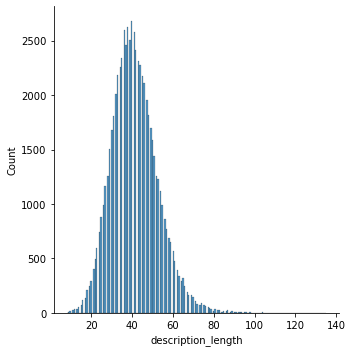

In [62]:
sns.displot(x=wine['description_length'])

<AxesSubplot:xlabel='description_length'>

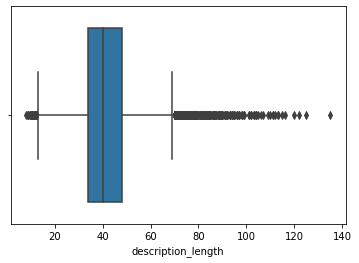

In [63]:
sns.boxplot(x=wine['description_length'])

In [68]:
reviews = []
corpus=[]
for review in wine['description']:
    reviews.append(review)
    corpus.append(nltk.sent_tokenize(review))

In [104]:
reviews

["aromas include tropical fruit, broom, brimstone and dried herb. the palate isn't overly expressive, offering unripened apple, citrus and dried sage alongside brisk acidity.",
 'pineapple rind, lemon pith and orange blossom start off the aromas. the palate is a bit more opulent, with notes of honey-drizzled guava and mango giving way to a slightly astringent, semidry finish.',
 "much like the regular bottling from 2012, this comes across as rather rough and tannic, with rustic, earthy, herbal characteristics. nonetheless, if you think of it as a pleasantly unfussy country wine, it's a good companion to a hearty winter stew.",
 'blackberry and raspberry aromas show a typical navarran whiff of green herbs and, in this case, horseradish. in the mouth, this is fairly full bodied, with tomatoey acidity. spicy, herbal flavors complement dark plum fruit, while the finish is fresh but grabby.',
 "here's a bright, informal red that opens with aromas of candied berry, white pepper and savory he

In [70]:
corpus

[['aromas include tropical fruit, broom, brimstone and dried herb.',
  "the palate isn't overly expressive, offering unripened apple, citrus and dried sage alongside brisk acidity."],
 ['pineapple rind, lemon pith and orange blossom start off the aromas.',
  'the palate is a bit more opulent, with notes of honey-drizzled guava and mango giving way to a slightly astringent, semidry finish.'],
 ['much like the regular bottling from 2012, this comes across as rather rough and tannic, with rustic, earthy, herbal characteristics.',
  "nonetheless, if you think of it as a pleasantly unfussy country wine, it's a good companion to a hearty winter stew."],
 ['blackberry and raspberry aromas show a typical navarran whiff of green herbs and, in this case, horseradish.',
  'in the mouth, this is fairly full bodied, with tomatoey acidity.',
  'spicy, herbal flavors complement dark plum fruit, while the finish is fresh but grabby.'],
 ["here's a bright, informal red that opens with aromas of candied

In [71]:
#corpus=[sent for sublist in corpus for sent in sublist]

corpus1 = []

for sublist in corpus:
    for sentence in sublist:
        corpus1.append(sentence)

In [73]:
len(corpus1)

187361

In [74]:
corpus = corpus1

In [75]:
## Text cleaning

for i in range(len(corpus)):
    corpus[i] = re.sub(r'\W+',' ',corpus[i]) # Replace everything non-alpahnumeric by ' '
    corpus[i] = re.sub(r'\s+',' ',corpus[i]) # Replace one or more whitespaces by  ' '
    corpus[i] = re.sub(r'\d+',' ',corpus[i]) # Replace one or more digits by  ' '
    

#remove wine variety names from corpus

In [97]:
wordfreq = {}
for sentence in corpus:
    words = sentence.split()
    for word in words:
        if ( word not in wordfreq.keys() ): 
            wordfreq[word] = 1 
        else: 
            wordfreq[word] += 1 

In [98]:
len(wordfreq)

24618

In [100]:
sorted(wordfreq.items(), key=lambda item: item[1], reverse=True)

[('and', 188337),
 ('the', 119649),
 ('a', 95805),
 ('of', 94150),
 ('with', 64023),
 ('this', 60590),
 ('is', 50020),
 ('it', 46480),
 ('wine', 40980),
 ('in', 35145),
 ('flavors', 32607),
 ('to', 29656),
 ('s', 29213),
 ('fruit', 26297),
 ('on', 24106),
 ('aromas', 22007),
 ('that', 21385),
 ('palate', 20477),
 ('finish', 17917),
 ('from', 17785),
 ('acidity', 17248),
 ('cherry', 16574),
 ('but', 16340),
 ('tannins', 15848),
 ('black', 15705),
 ('drink', 15107),
 ('ripe', 13838),
 ('are', 13579),
 ('has', 12137),
 ('red', 11503),
 ('for', 11346),
 ('oak', 10616),
 ('by', 10600),
 ('spice', 10457),
 ('notes', 9713),
 ('as', 9685),
 ('an', 9667),
 ('rich', 9366),
 ('its', 9360),
 ('dry', 8991),
 ('berry', 8827),
 ('now', 8673),
 ('full', 8645),
 ('nose', 8641),
 ('fresh', 8319),
 ('blend', 8269),
 ('plum', 7757),
 ('blackberry', 7361),
 ('offers', 7164),
 ('sweet', 7043),
 ('apple', 6979),
 ('well', 6907),
 ('soft', 6832),
 ('dark', 6805),
 ('cabernet', 6671),
 ('white', 6649),
 ('show

In [91]:
from nltk.corpus import stopwords

stop_words = list(stopwords.words('english')) 
len(stop_words)

179

In [92]:
for i in range(len(stop_words)):
    stop_words[i] = re.sub(r"\s*'\s*\w*","",stop_words[i])

#stop_words = [word for word in list(np.unique(stop_words)) if len(word) > 1]
stop_words

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 'you',
 'you',
 'you',
 'you',
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 'she',
 'her',
 'hers',
 'herself',
 'it',
 'it',
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 'that',
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each',
 'few',
 'more'

In [94]:
#remove words that are shorter than 3 letters long 

[('and', 188337),
 ('the', 119649),
 ('a', 95805),
 ('of', 94150),
 ('with', 64023),
 ('this', 60590),
 ('is', 50020),
 ('it', 46480),
 ('wine', 40980),
 ('in', 35145),
 ('flavors', 32607),
 ('to', 29656),
 ('s', 29213),
 ('fruit', 26297),
 ('on', 24106),
 ('aromas', 22007),
 ('that', 21385),
 ('palate', 20477),
 ('finish', 17917),
 ('from', 17785),
 ('acidity', 17248),
 ('cherry', 16574),
 ('but', 16340),
 ('tannins', 15848),
 ('black', 15705),
 ('drink', 15107),
 ('ripe', 13838),
 ('are', 13579),
 ('has', 12137),
 ('red', 11503),
 ('for', 11346),
 ('oak', 10616),
 ('by', 10600),
 ('spice', 10457),
 ('notes', 9713),
 ('as', 9685),
 ('an', 9667),
 ('rich', 9366),
 ('its', 9360),
 ('dry', 8991),
 ('berry', 8827),
 ('now', 8673),
 ('full', 8645),
 ('nose', 8641),
 ('fresh', 8319),
 ('blend', 8269),
 ('plum', 7757),
 ('blackberry', 7361),
 ('offers', 7164),
 ('sweet', 7043),
 ('apple', 6979),
 ('well', 6907),
 ('soft', 6832),
 ('dark', 6805),
 ('cabernet', 6671),
 ('white', 6649),
 ('show

In [101]:
corpus = [(wordfreq[key],key) for key in list(wordfreq.keys()) if key not in stop_words]

In [103]:
sorted(corpus, key=lambda item: item[0], reverse=True)

[(40980, 'wine'),
 (32607, 'flavors'),
 (26297, 'fruit'),
 (22007, 'aromas'),
 (20477, 'palate'),
 (17917, 'finish'),
 (17248, 'acidity'),
 (16574, 'cherry'),
 (15848, 'tannins'),
 (15705, 'black'),
 (15107, 'drink'),
 (13838, 'ripe'),
 (11503, 'red'),
 (10616, 'oak'),
 (10457, 'spice'),
 (9713, 'notes'),
 (9366, 'rich'),
 (8991, 'dry'),
 (8827, 'berry'),
 (8645, 'full'),
 (8641, 'nose'),
 (8319, 'fresh'),
 (8269, 'blend'),
 (7757, 'plum'),
 (7361, 'blackberry'),
 (7164, 'offers'),
 (7043, 'sweet'),
 (6979, 'apple'),
 (6907, 'well'),
 (6832, 'soft'),
 (6805, 'dark'),
 (6671, 'cabernet'),
 (6649, 'white'),
 (6616, 'shows'),
 (6470, 'vanilla'),
 (6434, 'texture'),
 (6430, 'crisp'),
 (6253, 'bodied'),
 (6190, 'light'),
 (6110, 'fruits'),
 (5685, 'bright'),
 (5630, 'raspberry'),
 (5582, 'citrus'),
 (5565, 'pepper'),
 (5222, 'chocolate'),
 (4945, 'dried'),
 (4762, 'good'),
 (4728, 'firm'),
 (4577, 'sauvignon'),
 (4561, 'lemon'),
 (4551, 'juicy'),
 (4543, 'vineyard'),
 (4530, 'years'),
 (451

In [ ]:
#remove wine names from list
#remove words that are shorter than 3 letters


In [108]:
# define a function that will create a list of tokens 

def tokenizer(df_column):
    
    values = []
    corpus = []
    for value in df_column:
        values.append(value)
        corpus.append(nltk.sent_tokenize(value))
        
    corpus = [sent for sublist in corpus for sent in sublist]
    
    for i in range(len(corpus)):
        corpus[i] = re.sub(r'\W+',' ',corpus[i]) # Replace everything non-alpahnumeric by ' '
        corpus[i] = re.sub(r'\s+',' ',corpus[i]) # Replace one or more whitespaces by  ' '
        corpus[i] = re.sub(r'\d+',' ',corpus[i]) # Replace one or more digits by  ' '
        
    return corpus

In [109]:
tokenizer(wine.description)

['aromas include tropical fruit broom brimstone and dried herb ',
 'the palate isn t overly expressive offering unripened apple citrus and dried sage alongside brisk acidity ',
 'pineapple rind lemon pith and orange blossom start off the aromas ',
 'the palate is a bit more opulent with notes of honey drizzled guava and mango giving way to a slightly astringent semidry finish ',
 'much like the regular bottling from   this comes across as rather rough and tannic with rustic earthy herbal characteristics ',
 'nonetheless if you think of it as a pleasantly unfussy country wine it s a good companion to a hearty winter stew ',
 'blackberry and raspberry aromas show a typical navarran whiff of green herbs and in this case horseradish ',
 'in the mouth this is fairly full bodied with tomatoey acidity ',
 'spicy herbal flavors complement dark plum fruit while the finish is fresh but grabby ',
 'here s a bright informal red that opens with aromas of candied berry white pepper and savory herb t

In [113]:
varieties = tokenizer(wine.variety)

In [112]:
def create_sorted_tuple_with_wordfreq(corpus):
    
    wordfreq = {}
    for sentence in corpus:
        words = sentence.split()
        for word in words:
            if ( word not in wordfreq.keys() ): 
                wordfreq[word] = 1 
            else: 
                wordfreq[word] += 1 
                
    stop_words = list(stopwords.words('english')) 
    
    for i in range(len(stop_words)):
        stop_words[i] = re.sub(r"\s*'\s*\w*","",stop_words[i])
    
    corpus = [(wordfreq[key],key) for key in list(wordfreq.keys()) if key not in stop_words]
    
    corpus = sorted(corpus, key=lambda item: item[0], reverse=True)
    
    return corpus

In [114]:
create_sorted_tuple_with_wordfreq(varieties)

[(16097, 'blend'),
 (10179, 'red'),
 (9872, 'pinot'),
 (8418, 'noir'),
 (6847, 'sauvignon'),
 (6548, 'chardonnay'),
 (5787, 'cabernet'),
 (4844, 'style'),
 (3444, 'bordeaux'),
 (2732, 'syrah'),
 (2488, 'blanc'),
 (2351, 'white'),
 (2010, 'nebbiolo'),
 (1970, 'tempranillo'),
 (1913, 'rosé'),
 (1907, 'zinfandel'),
 (1887, 'malbec'),
 (1884, 'riesling'),
 (1735, 'sparkling'),
 (1677, 'sangiovese'),
 (1401, 'merlot'),
 (1400, 'rhône'),
 (1257, 'champagne'),
 (784, 'franc'),
 (696, 'gris'),
 (694, 'gamay'),
 (644, 'grenache'),
 (607, 'gewürztraminer'),
 (589, 'glera'),
 (544, 'viognier'),
 (542, 'shiraz'),
 (402, 'petite'),
 (402, 'barbera'),
 (386, 'sirah'),
 (383, 'nero'),
 (362, 'corvina'),
 (345, 'molinara'),
 (344, 'rondinella'),
 (343, 'grigio'),
 (308, 'chenin'),
 (306, 'garnacha'),
 (278, 'grosso'),
 (243, 'avola'),
 (240, 'petit'),
 (236, 'melon'),
 (231, 'aglianico'),
 (206, 'prosecco'),
 (201, 'albariño'),
 (183, 'garganega'),
 (182, 'moscato'),
 (170, 'verdot'),
 (156, 'torronté

In [117]:
reviews = []
corpus=[]
for review in wine['description']:
    reviews.append(review)
    corpus.append(nltk.sent_tokenize(review))

In [136]:
sent = corpus[0][0]
sent

'aromas include tropical fruit, broom, brimstone and dried herb.'

In [145]:
words = nltk.word_tokenize(sent)
words

['aromas',
 'include',
 'tropical',
 'fruit',
 ',',
 'broom',
 ',',
 'brimstone',
 'and',
 'dried',
 'herb',
 '.']

In [154]:
paired_words = list(nltk.bigrams(words))
paired_words

[('aromas', 'include'),
 ('include', 'tropical'),
 ('tropical', 'fruit'),
 ('fruit', ','),
 (',', 'broom'),
 ('broom', ','),
 (',', 'brimstone'),
 ('brimstone', 'and'),
 ('and', 'dried'),
 ('dried', 'herb'),
 ('herb', '.')]

In [147]:
nltk.pos_tag(words)

[('aromas', 'NNS'),
 ('include', 'VBP'),
 ('tropical', 'JJ'),
 ('fruit', 'NN'),
 (',', ','),
 ('broom', 'NN'),
 (',', ','),
 ('brimstone', 'NN'),
 ('and', 'CC'),
 ('dried', 'VBD'),
 ('herb', 'NN'),
 ('.', '.')]

In [175]:
nltk.help.upenn_tagset('NN.*')

NN: noun, common, singular or mass
    common-carrier cabbage knuckle-duster Casino afghan shed thermostat
    investment slide humour falloff slick wind hyena override subhumanity
    machinist ...
NNP: noun, proper, singular
    Motown Venneboerger Czestochwa Ranzer Conchita Trumplane Christos
    Oceanside Escobar Kreisler Sawyer Cougar Yvette Ervin ODI Darryl CTCA
    Shannon A.K.C. Meltex Liverpool ...
NNPS: noun, proper, plural
    Americans Americas Amharas Amityvilles Amusements Anarcho-Syndicalists
    Andalusians Andes Andruses Angels Animals Anthony Antilles Antiques
    Apache Apaches Apocrypha ...
NNS: noun, common, plural
    undergraduates scotches bric-a-brac products bodyguards facets coasts
    divestitures storehouses designs clubs fragrances averages
    subjectivists apprehensions muses factory-jobs ...


In [151]:
nltk.help.upenn_tagset()

$: dollar
    $ -$ --$ A$ C$ HK$ M$ NZ$ S$ U.S.$ US$
'': closing quotation mark
    ' ''
(: opening parenthesis
    ( [ {
): closing parenthesis
    ) ] }
,: comma
    ,
--: dash
    --
.: sentence terminator
    . ! ?
:: colon or ellipsis
    : ; ...
CC: conjunction, coordinating
    & 'n and both but either et for less minus neither nor or plus so
    therefore times v. versus vs. whether yet
CD: numeral, cardinal
    mid-1890 nine-thirty forty-two one-tenth ten million 0.5 one forty-
    seven 1987 twenty '79 zero two 78-degrees eighty-four IX '60s .025
    fifteen 271,124 dozen quintillion DM2,000 ...
DT: determiner
    all an another any both del each either every half la many much nary
    neither no some such that the them these this those
EX: existential there
    there
FW: foreign word
    gemeinschaft hund ich jeux habeas Haementeria Herr K'ang-si vous
    lutihaw alai je jour objets salutaris fille quibusdam pas trop Monte
    terram fiche oui corporis ...
IN: preposition or

In [160]:
#noun_preceders = [a[1] for (a, b) in paired_words if b[1] == 'NOUN']

In [157]:
#words need to be tagged first

#noun_preceders = [a[1] for (a, b) in paired_words if b[1] == 'NOUN']

noun_preceders = []

for (a,b) in paired_words:
    if b == 'NOUN':
        noun_preceders.append(a)

In [169]:
text = ' '.join(reviews)

In [173]:
text

'aromas include tropical fruit, broom, brimstone and dried herb. the palate isn\'t overly expressive, offering unripened apple, citrus and dried sage alongside brisk acidity. pineapple rind, lemon pith and orange blossom start off the aromas. the palate is a bit more opulent, with notes of honey-drizzled guava and mango giving way to a slightly astringent, semidry finish. much like the regular bottling from 2012, this comes across as rather rough and tannic, with rustic, earthy, herbal characteristics. nonetheless, if you think of it as a pleasantly unfussy country wine, it\'s a good companion to a hearty winter stew. blackberry and raspberry aromas show a typical navarran whiff of green herbs and, in this case, horseradish. in the mouth, this is fairly full bodied, with tomatoey acidity. spicy, herbal flavors complement dark plum fruit, while the finish is fresh but grabby. here\'s a bright, informal red that opens with aromas of candied berry, white pepper and savory herb that carry 

In [176]:
tokens = nltk.word_tokenize(text)
default_tagger = nltk.DefaultTagger('NN')
default_tagger.tag(tokens)

[('aromas', 'NN'),
 ('include', 'NN'),
 ('tropical', 'NN'),
 ('fruit', 'NN'),
 (',', 'NN'),
 ('broom', 'NN'),
 (',', 'NN'),
 ('brimstone', 'NN'),
 ('and', 'NN'),
 ('dried', 'NN'),
 ('herb', 'NN'),
 ('.', 'NN'),
 ('the', 'NN'),
 ('palate', 'NN'),
 ('is', 'NN'),
 ("n't", 'NN'),
 ('overly', 'NN'),
 ('expressive', 'NN'),
 (',', 'NN'),
 ('offering', 'NN'),
 ('unripened', 'NN'),
 ('apple', 'NN'),
 (',', 'NN'),
 ('citrus', 'NN'),
 ('and', 'NN'),
 ('dried', 'NN'),
 ('sage', 'NN'),
 ('alongside', 'NN'),
 ('brisk', 'NN'),
 ('acidity', 'NN'),
 ('.', 'NN'),
 ('pineapple', 'NN'),
 ('rind', 'NN'),
 (',', 'NN'),
 ('lemon', 'NN'),
 ('pith', 'NN'),
 ('and', 'NN'),
 ('orange', 'NN'),
 ('blossom', 'NN'),
 ('start', 'NN'),
 ('off', 'NN'),
 ('the', 'NN'),
 ('aromas', 'NN'),
 ('.', 'NN'),
 ('the', 'NN'),
 ('palate', 'NN'),
 ('is', 'NN'),
 ('a', 'NN'),
 ('bit', 'NN'),
 ('more', 'NN'),
 ('opulent', 'NN'),
 (',', 'NN'),
 ('with', 'NN'),
 ('notes', 'NN'),
 ('of', 'NN'),
 ('honey-drizzled', 'NN'),
 ('guava', 'NN

In [178]:
tokenized_text = nltk.word_tokenize(text)
nltk.pos_tag(tokenized_text)

[('aromas', 'NNS'),
 ('include', 'VBP'),
 ('tropical', 'JJ'),
 ('fruit', 'NN'),
 (',', ','),
 ('broom', 'NN'),
 (',', ','),
 ('brimstone', 'NN'),
 ('and', 'CC'),
 ('dried', 'VBD'),
 ('herb', 'NN'),
 ('.', '.'),
 ('the', 'DT'),
 ('palate', 'NN'),
 ('is', 'VBZ'),
 ("n't", 'RB'),
 ('overly', 'RB'),
 ('expressive', 'JJ'),
 (',', ','),
 ('offering', 'VBG'),
 ('unripened', 'JJ'),
 ('apple', 'NN'),
 (',', ','),
 ('citrus', 'NN'),
 ('and', 'CC'),
 ('dried', 'JJ'),
 ('sage', 'NN'),
 ('alongside', 'RB'),
 ('brisk', 'JJ'),
 ('acidity', 'NN'),
 ('.', '.'),
 ('pineapple', 'NN'),
 ('rind', 'NN'),
 (',', ','),
 ('lemon', 'JJ'),
 ('pith', 'NN'),
 ('and', 'CC'),
 ('orange', 'NN'),
 ('blossom', 'NNS'),
 ('start', 'VBP'),
 ('off', 'IN'),
 ('the', 'DT'),
 ('aromas', 'NN'),
 ('.', '.'),
 ('the', 'DT'),
 ('palate', 'NN'),
 ('is', 'VBZ'),
 ('a', 'DT'),
 ('bit', 'RB'),
 ('more', 'RBR'),
 ('opulent', 'JJ'),
 (',', ','),
 ('with', 'IN'),
 ('notes', 'NNS'),
 ('of', 'IN'),
 ('honey-drizzled', 'JJ'),
 ('guava', 'N

In [194]:
text_stripped = re.sub(r'\W+',' ',text) # Replace everything non-alpahnumeric by ' '
text_stripped = re.sub(r'\s+',' ',text_stripped) # Replace one or more whitespaces by  ' '
text_stripped = re.sub(r'\d+',' ',text_stripped) # Replace one or more digits by  ' '

In [195]:
text_stripped

'aromas include tropical fruit broom brimstone and dried herb the palate isn t overly expressive offering unripened apple citrus and dried sage alongside brisk acidity pineapple rind lemon pith and orange blossom start off the aromas the palate is a bit more opulent with notes of honey drizzled guava and mango giving way to a slightly astringent semidry finish much like the regular bottling from   this comes across as rather rough and tannic with rustic earthy herbal characteristics nonetheless if you think of it as a pleasantly unfussy country wine it s a good companion to a hearty winter stew blackberry and raspberry aromas show a typical navarran whiff of green herbs and in this case horseradish in the mouth this is fairly full bodied with tomatoey acidity spicy herbal flavors complement dark plum fruit while the finish is fresh but grabby here s a bright informal red that opens with aromas of candied berry white pepper and savory herb that carry over to the palate it s balanced wit

In [188]:
#corpus = tokenizer(wine.description)

In [197]:
tokenized_text = nltk.word_tokenize(text_stripped)
tokenized_text

['aromas',
 'include',
 'tropical',
 'fruit',
 'broom',
 'brimstone',
 'and',
 'dried',
 'herb',
 'the',
 'palate',
 'isn',
 't',
 'overly',
 'expressive',
 'offering',
 'unripened',
 'apple',
 'citrus',
 'and',
 'dried',
 'sage',
 'alongside',
 'brisk',
 'acidity',
 'pineapple',
 'rind',
 'lemon',
 'pith',
 'and',
 'orange',
 'blossom',
 'start',
 'off',
 'the',
 'aromas',
 'the',
 'palate',
 'is',
 'a',
 'bit',
 'more',
 'opulent',
 'with',
 'notes',
 'of',
 'honey',
 'drizzled',
 'guava',
 'and',
 'mango',
 'giving',
 'way',
 'to',
 'a',
 'slightly',
 'astringent',
 'semidry',
 'finish',
 'much',
 'like',
 'the',
 'regular',
 'bottling',
 'from',
 'this',
 'comes',
 'across',
 'as',
 'rather',
 'rough',
 'and',
 'tannic',
 'with',
 'rustic',
 'earthy',
 'herbal',
 'characteristics',
 'nonetheless',
 'if',
 'you',
 'think',
 'of',
 'it',
 'as',
 'a',
 'pleasantly',
 'unfussy',
 'country',
 'wine',
 'it',
 's',
 'a',
 'good',
 'companion',
 'to',
 'a',
 'hearty',
 'winter',
 'stew',
 

In [198]:
tagged_words = nltk.pos_tag(tokenized_text)
tagged_words

[('aromas', 'NNS'),
 ('include', 'VBP'),
 ('tropical', 'JJ'),
 ('fruit', 'NN'),
 ('broom', 'NN'),
 ('brimstone', 'NN'),
 ('and', 'CC'),
 ('dried', 'VBD'),
 ('herb', 'NN'),
 ('the', 'DT'),
 ('palate', 'NN'),
 ('isn', 'NN'),
 ('t', 'VBD'),
 ('overly', 'RB'),
 ('expressive', 'JJ'),
 ('offering', 'NN'),
 ('unripened', 'JJ'),
 ('apple', 'NN'),
 ('citrus', 'NN'),
 ('and', 'CC'),
 ('dried', 'JJ'),
 ('sage', 'NN'),
 ('alongside', 'RB'),
 ('brisk', 'JJ'),
 ('acidity', 'NN'),
 ('pineapple', 'NN'),
 ('rind', 'NN'),
 ('lemon', 'NN'),
 ('pith', 'NN'),
 ('and', 'CC'),
 ('orange', 'NN'),
 ('blossom', 'NNS'),
 ('start', 'VBP'),
 ('off', 'IN'),
 ('the', 'DT'),
 ('aromas', 'NN'),
 ('the', 'DT'),
 ('palate', 'NN'),
 ('is', 'VBZ'),
 ('a', 'DT'),
 ('bit', 'RB'),
 ('more', 'RBR'),
 ('opulent', 'JJ'),
 ('with', 'IN'),
 ('notes', 'NNS'),
 ('of', 'IN'),
 ('honey', 'NN'),
 ('drizzled', 'VBN'),
 ('guava', 'NN'),
 ('and', 'CC'),
 ('mango', 'NN'),
 ('giving', 'VBG'),
 ('way', 'NN'),
 ('to', 'TO'),
 ('a', 'DT'),
 (

In [199]:
selected_tags = ['FW','JJ','NN','NNP','NNPS','NNS','VBD','VBG','VBN']

In [200]:
selected_words = []

for tup in tagged_words:
    if tup[1] in selected_tags:
        selected_words.append(tup[0])
    else:
        continue

In [207]:
len(selected_words)

1510578

In [209]:
selected_words_1 = []

for word in selected_words:
    if word not in stop_words:
        selected_words_1.append(word)
    else:
        continue

In [210]:
len(selected_words_1)

1486879

In [212]:
useful_words = ' '.join(selected_words_1)

In [213]:
useful_words

'aromas tropical fruit broom brimstone dried herb palate expressive offering unripened apple citrus dried sage brisk acidity pineapple rind lemon pith orange blossom aromas palate opulent notes honey drizzled guava mango giving way astringent semidry finish regular bottling rough tannic rustic earthy herbal characteristics unfussy country good companion hearty winter stew blackberry raspberry typical navarran whiff green herbs case mouth full bodied tomatoey acidity spicy herbal flavors dark plum fruit finish fresh grabby bright informal red aromas candied berry white pepper savory herb palate balanced fresh acidity soft tannins great depth flavor fresh apple pear fruits touch spice dry balanced acidity crisp texture soft supple oaky structure cabernet supported merlot coffee complete picture finishing strong end resulting value priced wine attractive flavor immediate accessibility baked plum molasses balsamic vinegar cheesy oak feed palate braced bolt acidity compact set saucy red ber

In [219]:
tokenized_useful_words = nltk.word_tokenize(useful_words)
bigram_useful_words = list(nltk.bigrams(tokenized_useful_words))

In [224]:
bigram_useful_words

[('aromas', 'tropical'),
 ('tropical', 'fruit'),
 ('fruit', 'broom'),
 ('broom', 'brimstone'),
 ('brimstone', 'dried'),
 ('dried', 'herb'),
 ('herb', 'palate'),
 ('palate', 'expressive'),
 ('expressive', 'offering'),
 ('offering', 'unripened'),
 ('unripened', 'apple'),
 ('apple', 'citrus'),
 ('citrus', 'dried'),
 ('dried', 'sage'),
 ('sage', 'brisk'),
 ('brisk', 'acidity'),
 ('acidity', 'pineapple'),
 ('pineapple', 'rind'),
 ('rind', 'lemon'),
 ('lemon', 'pith'),
 ('pith', 'orange'),
 ('orange', 'blossom'),
 ('blossom', 'aromas'),
 ('aromas', 'palate'),
 ('palate', 'opulent'),
 ('opulent', 'notes'),
 ('notes', 'honey'),
 ('honey', 'drizzled'),
 ('drizzled', 'guava'),
 ('guava', 'mango'),
 ('mango', 'giving'),
 ('giving', 'way'),
 ('way', 'astringent'),
 ('astringent', 'semidry'),
 ('semidry', 'finish'),
 ('finish', 'regular'),
 ('regular', 'bottling'),
 ('bottling', 'rough'),
 ('rough', 'tannic'),
 ('tannic', 'rustic'),
 ('rustic', 'earthy'),
 ('earthy', 'herbal'),
 ('herbal', 'charact

In [225]:
selected_words_1

['aromas',
 'tropical',
 'fruit',
 'broom',
 'brimstone',
 'dried',
 'herb',
 'palate',
 'expressive',
 'offering',
 'unripened',
 'apple',
 'citrus',
 'dried',
 'sage',
 'brisk',
 'acidity',
 'pineapple',
 'rind',
 'lemon',
 'pith',
 'orange',
 'blossom',
 'aromas',
 'palate',
 'opulent',
 'notes',
 'honey',
 'drizzled',
 'guava',
 'mango',
 'giving',
 'way',
 'astringent',
 'semidry',
 'finish',
 'regular',
 'bottling',
 'rough',
 'tannic',
 'rustic',
 'earthy',
 'herbal',
 'characteristics',
 'unfussy',
 'country',
 'good',
 'companion',
 'hearty',
 'winter',
 'stew',
 'blackberry',
 'raspberry',
 'typical',
 'navarran',
 'whiff',
 'green',
 'herbs',
 'case',
 'mouth',
 'full',
 'bodied',
 'tomatoey',
 'acidity',
 'spicy',
 'herbal',
 'flavors',
 'dark',
 'plum',
 'fruit',
 'finish',
 'fresh',
 'grabby',
 'bright',
 'informal',
 'red',
 'aromas',
 'candied',
 'berry',
 'white',
 'pepper',
 'savory',
 'herb',
 'palate',
 'balanced',
 'fresh',
 'acidity',
 'soft',
 'tannins',
 'great'

In [ ]:
wordfreq_words = {}
for word in wordfreq_words:
    words = sentence.split()
    for word in words:
        if ( word not in wordfreq.keys() ): 
            wordfreq[word] = 1 
        else: 
            wordfreq[word] += 1 